# Learn Python Data Analytics by Example - Chicago Traffic Crashes

### Introduction

While working towards my Master's in Business Analytics, I found that learning by example is the best way for me to learn Python data analytics.  Being given a dataset and a set of coding tasks is much more beneficial than reading a textbook or listening to a professor.  

I want to share this method of learning with others who will also benefit.  All you need is a Python development environment (I recommend [Jupyter Notebook](https://jupyter.org/)) and a willingness to learn and have fun.

Included in this article is a list of data analytics tasks, followed by a detailed walkthrough of how to complete the tasks.  Please try to complete the tasks yourself before reading through the walkthrough - you will get more out of it that way.  Do keep in mind that there are many many ways to solve coding problems, so your code likely will not match mine word for word and that is okay.

### Project Description

For this project we will use a dataset with a combined 1.5 million records, which represent traffic crashes reported in Chicago from 2013 to 2021 and the vehicles involved in them.  The dataset was created in February 2021 and contains data sourced from the [City of Chicago](https://data.cityofchicago.org/Transportation/Traffic-Crashes-Vehicles/68nd-jvt3).

You will need to install the [pandas](https://pandas.pydata.org/), [matplotlib](https://matplotlib.org/), [seaborn](https://seaborn.pydata.org/index.html) and [Folium](https://python-visualization.github.io/folium/) libraries, if you do not already have them.


### Data Analytics Tasks

Please perform the following tasks in Python using the *crashes.csv* and *crashes_vehicles.csv* datasets available from this [drive](https://1drv.ms/u/s!AoQYKisAOe1libRT6GTcLP6n_B75hA?e=yTTaEr).  Also refer to this [GitHub repo](https://github.com/nickdcox/learn-traffic-crashes).
1. Read the CSV files containing the Chicago traffic crash data.  Identify the column common to both files and merge them together on that column.  Then display the total number of reported crashes.
2. Change the ‘CRASH_DATE’ column to a date format.  Drop observations that did not occur in 2017, 2018 or 2019 (other years have incomplete data).
3. Display a plot showing the number of crashes that occur for each hour of the day.
4. Name the make of vehicle that was involved in the most daylight crashes in August 2018.  Remember that a crash can involve multiple vehicles.
5. Determine which weather condition was most prevalent for each type of crash.
6. Plot the primary contributing cause of reported crashes, from highest to lowest.
7. Display the 10 state license plates involved in the most crashes.  Remember that a crash can involve multiple vehicles.
8. Display the proportion of crashes in each month of 2019 where alcohol was determined to be the primary contributing cause.
9. Determine whether snowmobiles or recreational off-highway vehicles were involved in more crashes.
10. Display a cluster map showing the locations of crashes involving a hit and run.


### Data Dictionary

**crashes.csv:** Each row in the dataset represents a traffic crash reported in Chicago.

| Column Name | Description |
| :--- | :----------- |
| CRASH_RECORD_ID | A unique identifier for a crash. |
| CRASH_DATE | The date that the crash occured. |
| WEATHER_CONDITION | The weather at the time the crash occurred. |
| LIGHTING_CONDITION | The lighting condition at the time the crash occurred. |
| FIRST_CRASH_TYPE | The type of crash. |
| HIT_AND_RUN_I | An indicator (Y or N) as to whether the crash was a hit and run. |
| PRIM_CONTRIBUTORY_CAUSE | The primary cause of the crash. |
| LATITUDE / LONGITUDE | The coordinates where the crash occured. |

**crashes_vehicles.csv:** Each row in the dataset represents a vehicle involved in a crash reported in Chicago.

| Column Name | Description |
| :--- | :----------- |
| CRASH_RECORD_ID | A unique identifier for a crash. |
| CRASH_DATE | The date that the crash occurred. |
| VEHICLE_ID | A unique identifier for each vehicle involved in a crash, in lieu of not having the license plate data. |
| MAKE | The make of each vehicle involved in the crash. |
| LIC_PLATE_STATE | The state where each vehicle involved in a crash is registered. |
| VEHICLE_TYPE | The type of each vehicle involved in the crash. |

### Step 1: Read the CSV files containing the Chicago traffic crash data.  Identify the column common to both files and merge them together on that column.  Then display the total number of reported crashes.  We will need to use the merged DataFrame and the crashes DataFrame throughout this project.

In [1]:
import pandas as pd

# Import the source data and merge.
df_crashes = pd.read_csv('crashes.csv', low_memory=False)
df_vehicles = pd.read_csv('crashes_vehicles.csv', low_memory=False).drop('CRASH_DATE', axis=1)
df = pd.merge(df_crashes, df_vehicles, on='CRASH_RECORD_ID').reset_index()

# Display the total number of crashes.
print('Total Number of Reported Crashes:', df['CRASH_RECORD_ID'].nunique())

Total Number of Reported Crashes: 474262


#### Code Explanation:

We start by making the contents of the pandas module available to our program.  pandas is an easy to use open source data analysis and manipulation tool, built on top of the Python programming language.  We will use it extensively throughout this project.

```
import pandas as pd
```

We import the contents of the *crashes.csv* file by calling the read_csv() method and store it in a DataFrame, named *df_crashes*.  A DataFrame is a two-dimensional data structure with labeled axes, consisting of data, rows and columns.  Think of it like a table built in Microsoft Excel or Microsoft Access.  We then repeat the same action for the *crashes_vehicles.csv* file, naming it *df_vehicles*.  For the *crashes_vehicles.csv* file, we drop the 'CRASH_DATE' column as it is also included in the other file.

```
df_crashes = pd.read_csv('crashes.csv', low_memory=False)
df_vehicles = pd.read_csv('crashes_vehicles.csv', low_memory=False).drop('CRASH_DATE', axis=1)
```

To combine the two DataFrames into a single DataFrame, we call the merge() method of pandas.  We pass three parameters: the first two are the names of the two DataFrames that we are merging and the third specifies the column common to both.  Finally, with a call to the reset_index() function we reset the DataFrame index.

```
df = pd.merge(df_crashes, df_vehicles, on='CRASH_RECORD_ID').reset_index()
```

We use the print() function to print the string 'Total Number of Reported Crashes:' followed by the number of crashes in the DataFrame.  The parameter that we pass to the print() function is made up of two parts.  The first is the string 'Total Number of Reported Crashes:' surrounded in single quotes, denoting it as a string.  The second part of the parameter is calculating the number of crashes in *df*.  We use the nunique() method to calculate the number of unique CRASH_RECORD_ID in *df*, since a value can repeat.

```
print('Total Number of Reported Crashes:', df['CRASH_RECORD_ID'].nunique())
```

### Step 2: Change the ‘CRASH_DATE’ column to a date format.  Drop observations that did not occur in 2017, 2018 or 2019 (other years have incomplete data).  Do this for both the merged and the crash DataFrames.

In [2]:
# Change the CRASH_DATE column to date data type.
df['CRASH_DATE'] = pd.to_datetime(df['CRASH_DATE'])
df_crashes['CRASH_DATE'] = pd.to_datetime(df_crashes['CRASH_DATE'])

# Subset DataFrame to include only crashes from 2018, 2019 and 2020, because other years contain only partial data.
df = df[(df['CRASH_DATE'] >= '2018-01-01') & (df['CRASH_DATE'] <= '2020-12-31')]
df_crashes = df_crashes[(df_crashes['CRASH_DATE'] >= '2018-01-01') & (df_crashes['CRASH_DATE'] <= '2020-12-31')]

#### Code Explanation:

To convert the CRASH_DATE columns to a date type we use the pandas function to_datetime(), passing the columns to change as a parameter. 

```
df['CRASH_DATE'] = pd.to_datetime(df['CRASH_DATE'])
df_crashes['CRASH_DATE'] = pd.to_datetime(df_crashes['CRASH_DATE'])
```

We need to subset *df* and *df_crashes* to filter for crashes that occured in 2017, 2018 and 2019.  We use >= to represent greater than or equal to and <= to represent less than or equal to.  Dates are in the format YYYY-MM-DD.

```
df = df[(df['CRASH_DATE'] >= '2018-01-01') & (df['CRASH_DATE'] <= '2020-12-31')]
df_crashes = df_crashes[(df_crashes['CRASH_DATE'] >= '2018-01-01') & (df_crashes['CRASH_DATE'] <= '2020-12-31')]              
```

### Step 3. Display a plot showing the number of crashes that occur for each hour of the day.

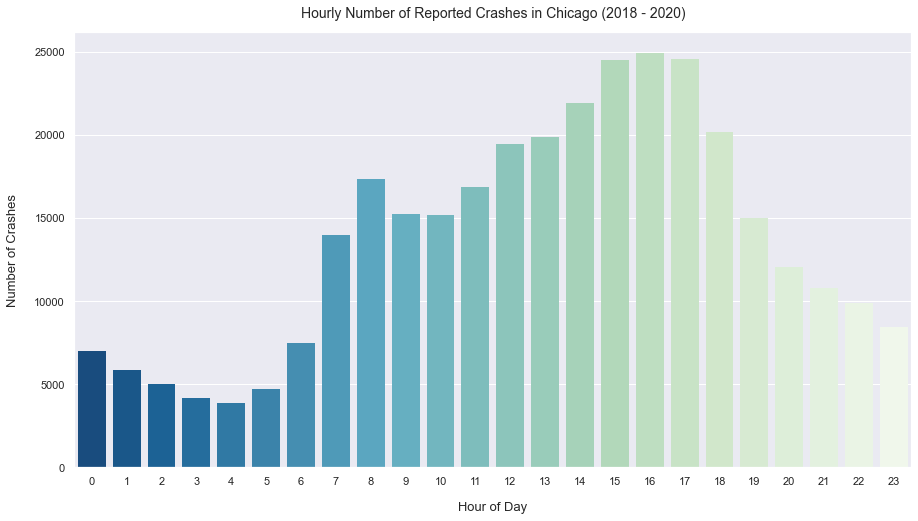

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style='darkgrid')

# Add column containing hour of day that crash occured.
df['Hour'] = df['CRASH_DATE'].dt.hour

# Plot number of crashes by hour of day.
plt.figure(figsize=(15,8))
s = sns.barplot(data=df.groupby('Hour')['CRASH_RECORD_ID'].nunique().reset_index(), x='Hour', y='CRASH_RECORD_ID', palette='GnBu_r', linewidth=0)
s.set_title('Hourly Number of Reported Crashes in Chicago (2018 - 2020)', y=1.02, fontsize=14)
s.set_xlabel('Hour of Day', fontsize=13, labelpad=15)
s.set_ylabel('Number of Crashes', fontsize=13, labelpad=15)
plt.show()

#### Code Explanation:

We make the contents of the matplotlib  and seaborn libraries available to our program. matplotlib and seaborn work together for creating visualizations in Python.  I have a stylistic preference for my plots and set the seaborn theme style to darkgrid by calling the set_theme() method of seaborn.  We also make the numpy library available to assist with labeling the axes of the plot.
```
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style='darkgrid')
import numpy as np
```

To make plotting easier and more visually appealing, we create a new column in the DataFrame to represent the hour within which each crash occured.  0 represents 12am to 1am, 1 represents 1am to 2am, all the way up to 23 which represents 11pm to 12am.  To achieve this we use .dt.hour on the CRASH_DATE column to obtain the hour and place it into a new column, Hour.

```
df['Hour'] = df['CRASH_DATE'].dt.hour
```

Now it is time for us to plot .  We specify 15 x 8 as the size of the plot and then call the barplot() method of seaborn.  We pass it 5 parameters, each of which we will take in turn.  The first parameter is the data we wish to plot: we group the records by our new Hour column and then count the number of unique CRASH_RECORD_ID in each group using the nunique() method.  The second and third parameters are the x and y for the plot, which are the Hour and count of crashes respectively.  The fourth parameter is the color palette chosen and the fifth specifies no line around the bars, a stylistic preference.

The remaining lines of code set the title and axes labels for the plot.

```
plt.figure(figsize=(15,8))
s = sns.barplot(data=df.groupby('Hour')['CRASH_RECORD_ID'].nunique().reset_index(), x='Hour', y='CRASH_RECORD_ID', palette='GnBu_r', linewidth=0)
s.set_title('Hourly Number of Reported Crashes in Chicago (2018 - 2020)', y=1.02, fontsize=14)
s.set_xlabel('Hour of Day', fontsize=13, labelpad=15)
s.set_ylabel('Number of Crashes', fontsize=13, labelpad=15)
plt.show()
```

### Step 4. Name the make of vehicle that was involved in the most daylight crashes in August 2018.  Remember that a crash can involve multiple vehicles.

In [4]:
# Subset the DataFrame for crashes that occurred during daylight.
df_daylight = df[df['LIGHTING_CONDITION'] == 'DAYLIGHT']

# Determine the make of vehicle involved in the most crashes.
df_daylight['MAKE'].value_counts().nlargest(1)

CHEVROLET    49779
Name: MAKE, dtype: int64

#### Code Explanation:

The first task we need to perform is to create a DataFrame containing only crashes that occured during daylight lighting conditions.  We start with *df* rather than *df_crashes* because we want to consider all vehicles involved in a crash.  We do that by simply subsetting *df* for records with DAYLIGHT in the LIGHTING_CONDITION column and store the result in *df_daylight*.

```
df_daylight = df[df['LIGHTING_CONDITION'] == 'DAYLIGHT']
```

Now that we have our source data ready, we call the value_counts() method on the MAKE column in the DataFrame to calculate the number of occurrences of each MAKE.  Because we only want to know the make of vehicle with the most crashes, we use nlargest(1) to display just the data what we need. 

```
df_daylight['MAKE'].value_counts().nlargest(1)
```

### Step 5. Determine which weather condition was most prevalent for each type of crash.

In [5]:
df_crashes.groupby('FIRST_CRASH_TYPE')['WEATHER_CONDITION'].apply(lambda x: x.value_counts().head(1)).reset_index(name='COUNT').rename(columns={'level_1': 'WEATHER'})

,FIRST_CRASH_TYPE,WEATHER,COUNT
0,ANGLE,CLEAR,27838
1,ANIMAL,CLEAR,208
2,FIXED OBJECT,CLEAR,12207
3,HEAD ON,CLEAR,2118
4,OTHER NONCOLLISION,CLEAR,825
5,OTHER OBJECT,CLEAR,2573
6,OVERTURNED,CLEAR,141
7,PARKED MOTOR VEHICLE,CLEAR,58069
8,PEDALCYCLIST,CLEAR,4517
9,PEDESTRIAN,CLEAR,6547


#### Code Explanation:

We are able to use a single line of code for this step.  Because it is a long line code, I will break it down in to parts for explanation.

We start by grouping the crash records in *df_crashes* by FIRST_CRASH_TYPE.

```
df_crashes.groupby('FIRST_CRASH_TYPE')['WEATHER_CONDITION']
```

Next, we want to determine which weather condition has the most crashes for each of the crash types.  To do this we need to apply a function along an axis of the grouped data.  Because we do not specify the axis, it defaults to 0, which is the index.  

The lambda function calls the value_counts() method on each group (crash type) and counts the number of instances of each weather condition per group, in descending order.  The call to the head() method then gives us the top weather condition for each crash type group.

```
.apply(lambda x: x.value_counts().head(1))
```

We use the the reset_index() method to reset the DataFrame index to the original one.  We use it here to present the results in a more elegant manner.  We pass the name parameter of 'COUNT' to name the column containing the count values.

```
.reset_index(name='COUNT')
```

Finally, we call the rename() method to rename the level_1 column as WEATHER, to make the output more readable.

```
.rename(columns={'level_1': 'WEATHER'})
```

### Step 6. Plot the primary contributing cause of reported crashes, from highest to lowest.

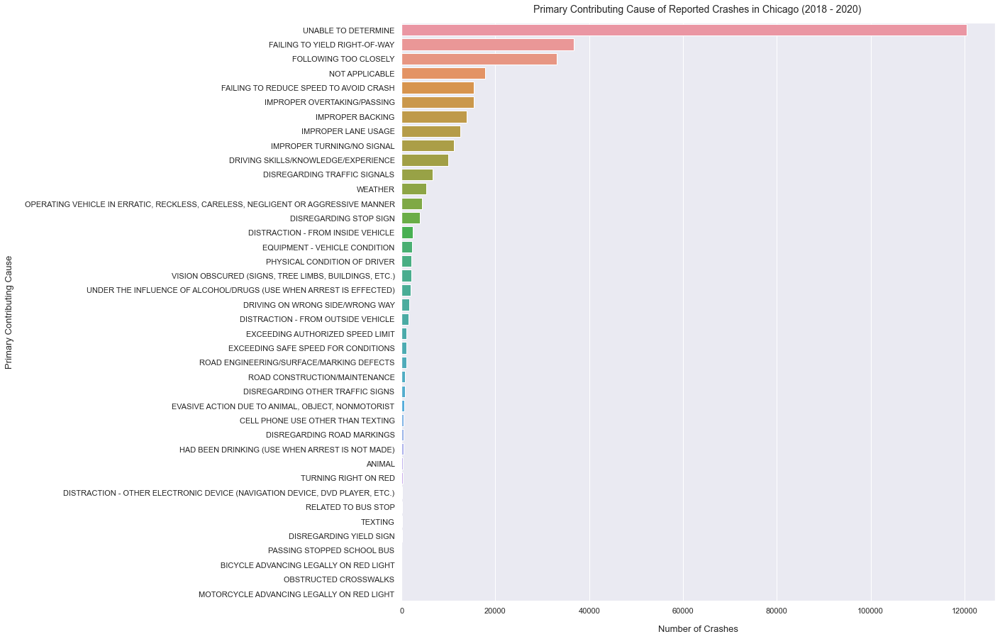

In [6]:
# Display a plot showing the primary contributing cause of reported crashes.
plt.figure(figsize=(15, 15))
sns.countplot(data=df_crashes,  y='PRIM_CONTRIBUTORY_CAUSE', order = df_crashes['PRIM_CONTRIBUTORY_CAUSE'].value_counts().index)
plt.title('Primary Contributing Cause of Reported Crashes in Chicago (2018 - 2020) ', y=1.01, fontsize=14)
plt.xlabel('Number of Crashes', fontsize=13, labelpad=15)
plt.ylabel('Primary Contributing Cause', fontsize=13, labelpad=15)
plt.show();

#### Code Explanation:

Much of the code we use here is similar to the plot we created in step 3.

We specify 15 x 15 as the size of the plot and then call the countplot() method of seaborn.  We pass it 3 parameters.  The first is our *df_crashes* DataFrame.  The second specifies that we wish to count the number of crashes for each primary contributory cause and by specifying *y* the bars will display horizontally on the plot.  Because seaborn does not have an easy way to order the bars by size, for the third parameter *order* we tell seaborn to use the result of *df_crashes['PRIM_CONTRIBUTORY_CAUSE'].value_counts().index*  to order the bars.  This gives the descending order that we are looking for.

The remaining lines of code set the title and axes labels for the plot.

```
plt.figure(figsize=(15, 15))
sns.countplot(data=df_crashes,  y='PRIM_CONTRIBUTORY_CAUSE', order = df_crashes['PRIM_CONTRIBUTORY_CAUSE'].value_counts().index)
plt.title('Primary Contributing Cause of Reported Crashes in Chicago (2018 - 2020) ', y=1.01, fontsize=14)
plt.xlabel('Number of Crashes', fontsize=13, labelpad=15)
plt.ylabel('Primary Contributing Cause', fontsize=13, labelpad=15)
plt.show();
```

### Step 7. Display the 10 state license plates involved in the most crashes.  Remember that a crash can involve multiple vehicles.

In [7]:
df.groupby('LIC_PLATE_STATE')['VEHICLE_ID'].count().nlargest(10).reset_index(name='COUNT')

,LIC_PLATE_STATE,COUNT
0,IL,550630
1,XX,12128
2,IN,11914
3,WI,3793
4,MI,2554
5,FL,1802
6,TX,1739
7,OH,1516
8,AZ,1333
9,IA,1121


#### Code Explanation:

We start with *df* rather than *df_crashes* because we want to consider all vehicles involved in a crash.  We group the records by LIC_PLATE_STATE and then count the number of VEHICLE_ID for each group.  We use this field, because it is a unique identifier for each vehicle in lieu of not having the actual license plate data.  Because we want the top 10, we call the .nlargest(10) method.  Finally we call reset_index() and name the count column as COUNT.

```
df.groupby('LIC_PLATE_STATE')['VEHICLE_ID'].count().nlargest(10).reset_index(name='COUNT')
```

### Step 8. Display the proportion of crashes in each month of 2019 where alcohol was determined to be the primary contributing cause.

In [8]:
# Subset to crashes reported in 2019 and count number of crashes per month.
df_alcohol = df_crashes[(df_crashes['CRASH_DATE'] >= '2019-01-01') & (df_crashes['CRASH_DATE'] <= '2019-12-31')]
df_total = df_alcohol.groupby(df_alcohol['CRASH_DATE'].dt.strftime('%m'))['CRASH_RECORD_ID'].nunique()

# Subset to crashes with alcohol as the primary contributing cause and count number per month.
df_alcohol = df_crashes[df_crashes['PRIM_CONTRIBUTORY_CAUSE'].str.contains('ALCOHOL|DRINKING')]
df_alcohol = df_alcohol.groupby(df_alcohol['CRASH_DATE'].dt.strftime('%m'))['CRASH_RECORD_ID'].nunique()

# Calculate the porportions and display a well formatted result.
df_proportion = df_alcohol / df_total * 100
df_proportion.reset_index().rename(columns={'CRASH_DATE': 'MONTH', 'CRASH_RECORD_ID': 'PROPORTION'})

,MONTH,PROPORTION
0,01,2.062308
1,02,2.179710
2,03,2.113254
3,04,1.704606
4,05,1.830407
5,06,1.718662
6,07,2.111090
7,08,2.062374
8,09,2.313258
9,10,2.203884


#### Code Explanation:

Because we are only interested in 2019 crashes, we subset *df_crashes* using data filters to give us *df_alcohol*.  With the second line of code we group the crashes by month and then count the number of crashes per month by calling the nunique() method, storing the result as *df_total* - this will be the denominator when we calculate the monthly proportions.

```
df_alcohol = df_crashes[(df_crashes['CRASH_DATE'] >= '2019-01-01') & (df_crashes['CRASH_DATE'] <= '2019-12-31')]
df_total = df_alcohol.groupby(df_alcohol['CRASH_DATE'].dt.strftime('%m'))['CRASH_RECORD_ID'].nunique()
```

Now we need the numerator, which is the number of alcohol related crashes per month.  Firstly, we group the crashes by the primary contributing cause, but only if they contain the words ALCOHOL or DRINKING.  A call to the contains() method, passing the words as a parameter gives us what we need.  We use the | character to separate the two words.  Next we group the resulting records by month and then count the number of crashes per month by calling the nunique() method again, storing the result back in to *df_alcohol*.

```
df_alcohol = df_crashes[df_crashes['PRIM_CONTRIBUTORY_CAUSE'].str.contains('ALCOHOL|DRINKING')]
df_alcohol = df_alcohol.groupby(df_alcohol['CRASH_DATE'].dt.strftime('%m'))['CRASH_RECORD_ID'].nunique()
```

Now that we have both the numerator and denominator, we can calculate the monthly proportions of crashes where alcohol was recorded as a primary contributing cause.  We then call reset_index() like in other steps and use rename() to rename the columns for display purposes.

```
df_proportion = df_alcohol / df_total * 100
df_proportion.reset_index().rename(columns={'CRASH_DATE': 'MONTH', 'CRASH_RECORD_ID': 'PROPORTION'})
```

### Step 9. Determine whether snowmobiles or recreational off-highway vehicles were involved in more crashes.

In [9]:
print('Number of snowmobiles:', str(len(df[df['VEHICLE_TYPE'] == 'SNOWMOBILE'])))

Number of snowmobiles: 4


In [10]:
print('Number of recreational off-highway vehicles:', str(len(df[df['VEHICLE_TYPE'] == 'RECREATIONAL OFF-HIGHWAY VEHICLE (ROV)'])))

Number of recreational off-highway vehicles: 6


#### Code Explanation:

For this step we use the same code twice, firstly looking for snowmobiles and secondly for recreational off-highway vehicles.  We subset *df* for each vehicle type and use the len() function to count the number of records in the respective subsets.

```
print('Number of snowmobiles:', str(len(df[df['VEHICLE_TYPE'] == 'SNOWMOBILE'])))
print('Number of recreational off-highway vehicles:', str(len(df[df['VEHICLE_TYPE'] == 'RECREATIONAL OFF-HIGHWAY VEHICLE (ROV)'])))
```

### Step 10. Display a cluster map showing the locations of crashes involving a hit and run.

In [11]:
# Subset to crashes involving a hit and run and drop records without location coordinates.
df_hitrun = df_crashes[df_crashes['HIT_AND_RUN_I'] == 'Y']
df_hitrun = df_hitrun[df_hitrun['LONGITUDE'].notna()]

In [12]:
import folium
from folium import plugins

# Create a map centered on Chicago.
m = folium.Map(location=[41.8781, -87.6798], zoom_start=12)

# Instantiate a mark cluster object for the hit and run crashes.
hitrun = plugins.MarkerCluster().add_to(m)

# Display only crashes where hit and run was reported.
for lat, lng in zip(df_hitrun['LATITUDE'], df_hitrun['LONGITUDE']):
    folium.Marker(
        location=[lat, lng],
           icon=None,
    ).add_to(hitrun)

# Display the map.
m

#### Code Explanation:

We only wish to display the locations of crashes involving hit and runs, so we start by subsetting *df_crashes* to get the data we wish to plot, storing the result as *df_hitrun*.  There are some records in the DataFrame without coordindates, so we remove them by using the notna() method.

```
df_hitrun = df_crashes[df_crashes['HIT_AND_RUN_I'] == 'Y']
df_hitrun = df_hitrun[df_hitrun['LONGITUDE'].notna()]
```

To display our map we are going to use Folium and an associated marker cluster plugin. We start by making the contents of the Folium module available to our program and importing the plugins.  Folium is very powerful and requires little code to create an interactive map with great detail.

```
import folium
from folium import plugins
```

We need to instantiate a Folium map, by passing the GPS coordinates of Chicago and a zoom level, which we will set to 12.  The latitude we will use is 41.8781 and the longitude -87.6798 (I found these with a quick Google search).

```
m = folium.Map(location=[41.8781, -87.6798], zoom_start=12)
```

We are creating a cluster map, so use the MarkerCluster plugin, adding it to our map with a call to the add_to() method and passing our Folium map *m* as a parameter.

Then for each crash in *df_hitrun* we create a marker.  We iterate through *df_hitrun* using a for loop.  The zip() function creates a tuple of latitude and longitude for each crash, creating a marker for each.  Finally, we display the map *m*.  As you zoom in and out of the map, the clusters resize interactively.

```
hitrun = plugins.MarkerCluster().add_to(m)

for lat, lng in zip(df_hitrun['LATITUDE'], df_hitrun['LONGITUDE']):
    folium.Marker(
        location=[lat, lng],
           icon=None,
    ).add_to(hitrun)
m
```